In [26]:
%matplotlib inline
import os
import argparse
import matplotlib
import numpy as np
import skimage as ski
from plantcv import plantcv as pcv
import pandas as pd
import matplotlib.pyplot as plt
import imageio.v3 as io
from datetime import datetime
import PIL
from skimage.filters import threshold_otsu
import cv2
# from PIL import Image               # to load images
# from IPython.display import display # to display images

from IPython.display import Image, display
from IPython.display import HTML


In [3]:
GLOBAL_PARENT_DIRECTORY = "./image/"
GLOBAL_PLANTCV_MODE = False
GLOBAL_DEBUG_MODE = True
GLOBAL_OUTPUT_DIR = "img_output"
GLOBAL_RESULT_DIR = "data_output"
GLOBAL_PROPERTY_CSV_NAME = "properties.csv"

GLOBAL_DATSET_FIELD_NAMES = ["Name", 
                             "Date", 
                             "Red 1", 
                             "Green 1", 
                             "Blue 1", 
                             "Intensity 1", 
                             "Red 2", 
                             "Green 2", 
                             "Blue 2", 
                             "Intensity 2", 
                             "Area", 
                             "opencv",
                             "otsu",
                             "hue",
                             "saturation",
                             "value"
                             ]

In [5]:
# Function to calculate plant area using a specified method
def calculate_plant_area(image_path = None, image_name = None, method = "plantcv", debug = False):
    if image_name:
        image_path = GLOBAL_PARENT_DIRECTORY + "Farm 1" + "/" + image_name
    result = {}
    # Read the image
    image = cv2.imread(image_path)
    steps = [[image, "original"]]
    # Apply the selected method to segment and calculate plant area
    if method == "plantcv":
        a = pcv.rgb2gray_lab(image, channel='a')
        steps.append([a, "rgb2gray", "gray"])
        a_tresh = pcv.threshold.binary(gray_img=a, threshold=120, object_type='dark')
        steps.append([a_tresh, "pcv thres"])
        # Fill in small objects
        a_fill_image = pcv.fill(bin_img=a_tresh, size=50)
        # steps.append([a, "rgb2gray"])
        result['pixels'] = np.count_nonzero(a_fill_image)
        # if a_fill_image.sum() > 0:  # Check if there are plant pixels
        #     mask = a_fill_image  # Use the filled mask for size analysis
        #     size_analysis = pcv.analyze.size(img=image, labeled_mask=mask, n_labels=1)
        #     steps.append([size_analysis, "size"])
        #     result['size'] = size_analysis
        #     # size_analysis is a dictionary containing various object properties
        # else:
        #     size_analysis = None
        
        # plant_area = pcv.image_analysis.analyze_object(img=a, obj=mask)['area']
    elif method == "opencv":
        # Convert to HSV color space (better for plant color differentiation)
      hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
      steps.append([hsv_image, "hsv"])
      # Define color range for green (adjust based on your microgreens' color)
      lower_green = np.array([40, 50, 50])
      upper_green = np.array([80, 255, 255])
    
      # Mask based on the green color range
      mask = cv2.inRange(hsv_image, lower_green, upper_green)
      
      # Apply morphological operations (optional)
      kernel = np.ones((5, 5), np.uint8)
      mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
      mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
      steps.append([mask, "mask"])
      # Find contours of potential microgreens
      contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
      # Analysis results dictionary
      results = {}
    
      # 1. Total Microgreen Area
      total_area = 0
      for cnt in contours:
        area = cv2.contourArea(cnt)
        total_area += area
      result["pixels"] = total_area
    
      # 2. Color Features
      # Extract average hue, saturation, and value from the mask
      mask_hsv = hsv_image[mask > 0]  # Get pixels within the mask
      avg_hue = np.mean(mask_hsv[:, 0])
      avg_saturation = np.mean(mask_hsv[:, 1])
      avg_value = np.mean(mask_hsv[:, 2])
      result["avg_hue"] = avg_hue
      result["avg_saturation"] = avg_saturation
      result["avg_value"] = avg_value
    elif method == "otsu":
        green_channel = image[:, :, 1]
        steps.append([green_channel, "green"])
        # Apply Otsu's threshold to the green channel to segment the image
        thresh = threshold_otsu(green_channel)
        binary = green_channel > thresh
        steps.append([binary, "binary", "dar"])
        result['pixels'] = binary.sum()  
    else:
        raise ValueError("Invalid method")
    if debug:
        plt.figure(figsize=(12, 6))
        index = 1
        for step in steps:
            plt.subplot(1, 3, index)
            plt.title(step[1])
            if len(step) > 2:
                plt.imshow(step[0], cmap="gray")
            else:
                plt.imshow(step[0])
            plt.axis('off')        
            index += 1
        plt.show()
    height, width = image.shape[:2]
    result['per'] = round(100 * result['pixels']/(height * width), 4)
    return result

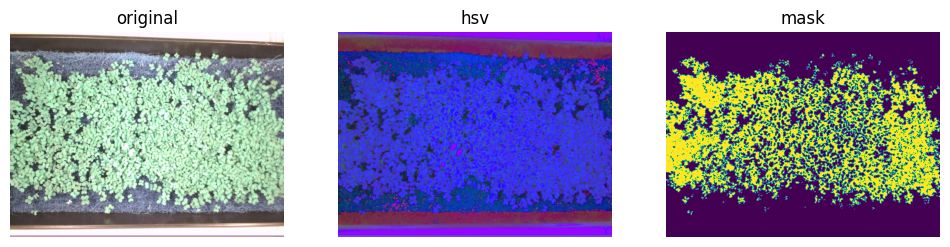

{'pixels': 5213752.5,
 'avg_hue': 54.96484625998781,
 'avg_saturation': 61.480104739595035,
 'avg_value': 211.8246941565318,
 'per': 47.144}

In [6]:
# calculate_plant_area(image_name = farm_dataset.dataset[0]['Images'][-1], method = "plantcv")

calculate_plant_area(image_path = args.farm1[-1], method = "opencv", debug= True)

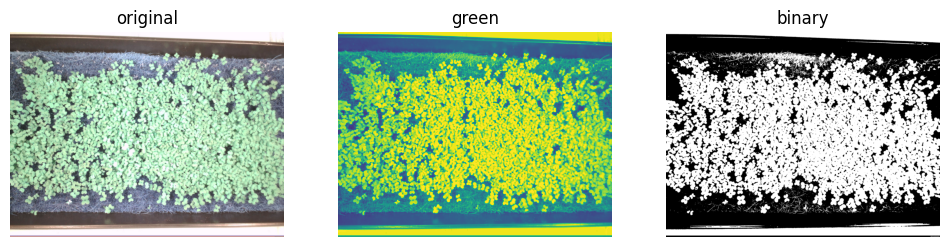

{'pixels': 6438263, 'per': 58.2164}

In [7]:
calculate_plant_area(image_path = args.farm1[-1], method = "otsu", debug= True)

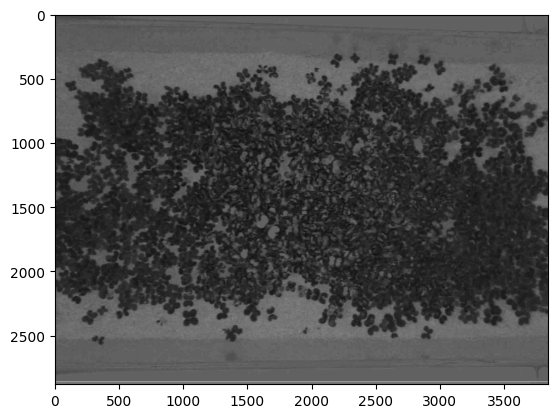

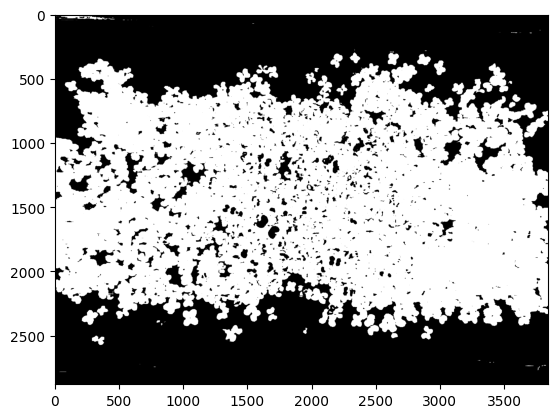

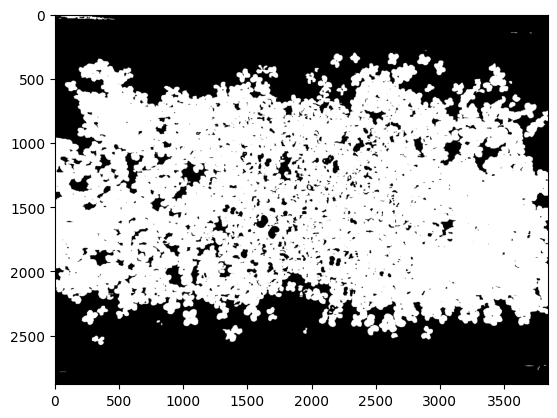

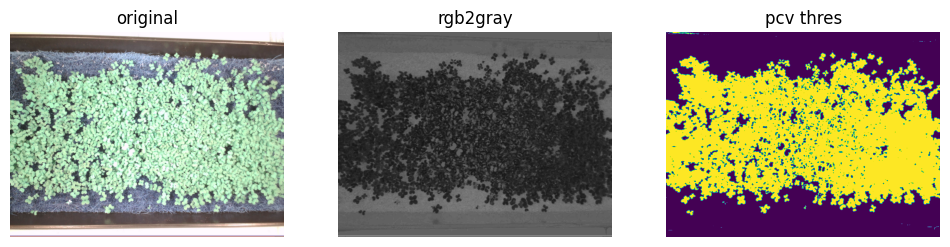

{'pixels': 5899340, 'per': 53.3433}

In [8]:
calculate_plant_area(image_path = args.farm1[-1], method = "plantcv", debug= True)

In [9]:
class Farm_Dataset:
    
    dataset = []
    
    @classmethod
    def add_new_data_instance(self, path):
        # Get the name, images, and RGBI values from the specified path
        name = os.path.basename(os.path.normpath(path))
        farm_images = [image for image in os.listdir(path) if image.endswith(".jpg")]
        rgbi_values = pd.read_csv(path + '/' + GLOBAL_PROPERTY_CSV_NAME)
        
        # Error checking
        if name == None or farm_images == None or rgbi_values.empty:
            return
        
        self.dataset.append({"Instance Name" : name, "Images" : farm_images, "RGBI Values" : rgbi_values})
        
    @classmethod
    def print_rgb_images(self, farm_image_array, path):
        for img in farm_image_array:
               plot_image(path + img)
                
    @classmethod
    def print_rgb_values(self, farm_image_array, path):
        for img in farm_image_array:
            print(iio.imread(uri=path + img))
    
    @classmethod
    def plot_image(self, img):
        plant = iio.imread(uri=img)
    
        fig, ax = plt.subplots()
        plt.imshow(plant)
    
        return plant
        
    @classmethod
    def get_preprocessed_farm_data(self):
        preprocessed_farm_data_list = list()
        
        for instance in self.dataset:
            self.preprocess_single_instance(instance, preprocessed_farm_data_list)
        
        return preprocessed_farm_data_list
        
    @classmethod
    def preprocess_single_instance(self, instance, preprocessed_farm_data_list):
        preprocessed_farm_data = pd.DataFrame(columns=GLOBAL_DATSET_FIELD_NAMES)
        
        print("Processing  " + instance["Instance Name"]) if GLOBAL_DEBUG_MODE else None
        
        debug_index = 1
        for (img_path, date) in zip(instance["Images"], self.get_dates(instance["Images"])):
            print("Processing image " + str(debug_index) + " - " + str(date)) if GLOBAL_DEBUG_MODE else None
            
            # img, path, filename = pcv.readimage(filename=GLOBAL_PARENT_DIRECTORY + instance["Instance Name"] + "/" + img_path)

            # # convert the image to grayscale colorspace
            # a = pcv.rgb2gray_lab(img, channel='a')

            # # create the histogram of the grayscale image
            # #hist = pcv.visualize.histogram(a)

            # # threshold/segment plant material from the background 
            # a_tresh = pcv.threshold.binary(gray_img=a, threshold=120, object_type='dark')

            # # Fill in small objects
            # a_fill_image = pcv.fill(bin_img=a_tresh, size=50)

            # # count the number of white pixel which represent the plant material
            # plantPixels = np.count_nonzero(a_fill_image)
            image_path = GLOBAL_PARENT_DIRECTORY + instance["Instance Name"] + "/" + img_path
            plantcv = calculate_plant_area(image_path, method = "plantcv")['per']
            opencvres = calculate_plant_area(image_path, method = "opencv")
            otsu = calculate_plant_area(image_path, method = "otsu")['per']

            preprocessed_farm_data.loc[-1] = [instance["Instance Name"],
                                              date,
                                              instance["RGBI Values"].iloc[0]["R1"],
                                              instance["RGBI Values"].iloc[0]["G1"],
                                              instance["RGBI Values"].iloc[0]["B1"],
                                              instance["RGBI Values"].iloc[0]["I1"],
                                              instance["RGBI Values"].iloc[0]["R2"],
                                              instance["RGBI Values"].iloc[0]["G2"],
                                              instance["RGBI Values"].iloc[0]["B2"],
                                              instance["RGBI Values"].iloc[0]["I2"],
                                              plantcv,
                                              opencvres['per'],
                                              otsu,
                                              opencvres['avg_hue'],
                                              opencvres['avg_saturation'],
                                              opencvres['avg_value']
                                              ]
 
            preprocessed_farm_data.index = preprocessed_farm_data.index + 1
            preprocessed_farm_data = preprocessed_farm_data.sort_index()
            
            debug_index = debug_index + 1
        #End for
        preprocessed_farm_data_list.append(preprocessed_farm_data)
    # End "preprocess_single_instance"
        
    @classmethod
    def get_dates(self, images):
        dates = list()
        for date in images:
            date_str = date.split(".jpg")[0]
            date_obj = datetime.strptime(date_str, '%m-%d-%Y_%H.%M.%S')
            dates.append(date_obj)
        return dates
    
    @classmethod 
    def scatter_plot(dates, newlist):
        plt.figure(figsize=(10, 8), dpi=80)

        # assign categories
        categories = np.array([0, 1, 2, 0, 1, 2, 0, 1, 2])

        # use colormap
        colormap = np.array(['r', 'g', 'b'])
        
        plt.xticks(rotation=25, ha='right')
        plt.scatter(dates, newlist,  c=colormap[categories])
        plt.gca().update(dict(title='Total Plant Area', xlabel='Period', ylabel='Area (cm^2)'))

        # Loop for annotation of all points 
        for i in range(len(dates)): 
            plt.annotate(newlist[i], (dates[i], newlist[i] + 0.2)) 

In [10]:
farm_dataset = Farm_Dataset()
pcv.params.debug_outdir = GLOBAL_OUTPUT_DIR
pcv.params.debug = GLOBAL_PLANTCV_MODE



In [11]:
farm_dataset.add_new_data_instance('./image/Farm 1')

# for pathname in os.listdir(GLOBAL_PARENT_DIRECTORY):
#     if os.path.isdir(GLOBAL_PARENT_DIRECTORY + pathname):
#         farm_dataset.add_new_data_instance(GLOBAL_PARENT_DIRECTORY + pathname)
#         break

In [12]:
preprocessed_farm_data_list = farm_dataset.get_preprocessed_farm_data()

Processing  Farm 1
Processing image 1 - 2023-11-14 01:52:32
Processing image 2 - 2023-11-11 21:21:42
Processing image 3 - 2023-11-11 23:24:25
Processing image 4 - 2023-11-11 16:14:51
Processing image 5 - 2023-11-11 23:44:49
Processing image 6 - 2023-11-09 23:45:31
Processing image 7 - 2023-11-14 02:26:37
Processing image 8 - 2023-11-14 04:53:54
Processing image 9 - 2023-11-10 23:17:39
Processing image 10 - 2023-11-07 17:57:01
Processing image 11 - 2023-11-14 00:44:22
Processing image 12 - 2023-11-07 22:29:45
Processing image 13 - 2023-11-08 23:16:54
Processing image 14 - 2023-11-09 17:24:41
Processing image 15 - 2023-11-07 00:01:58
Processing image 16 - 2023-11-07 15:06:32
Processing image 17 - 2023-11-14 04:08:53
Processing image 18 - 2023-11-10 23:25:49
Processing image 19 - 2023-11-10 23:42:11
Processing image 20 - 2023-11-08 23:55:21
Processing image 21 - 2023-11-07 19:05:13
Processing image 22 - 2023-11-08 23:38:18
Processing image 23 - 2023-11-07 23:20:13
Processing image 24 - 20

In [13]:
if GLOBAL_DEBUG_MODE:
    for farm_data in preprocessed_farm_data_list:
        display(farm_data)

,Name,Date,Red 1,Green 1,Blue 1,Intensity 1,Red 2,Green 2,Blue 2,Intensity 2,Area,opencv,otsu,hue,saturation,value
0,Farm 1,2023-11-10 17:58:30,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,39.0178,21.7449,50.7099,60.264831,58.498877,221.501169
1,Farm 1,2023-11-10 20:14:52,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,39.3353,20.2958,51.3046,61.374327,57.315240,221.063271
2,Farm 1,2023-11-13 21:53:55,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,52.3677,47.0843,57.4974,54.311402,61.872621,212.753184
3,Farm 1,2023-11-10 23:50:22,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,41.8387,23.0895,51.7313,61.046414,57.454730,218.509041
4,Farm 1,2023-11-14 05:06:12,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,53.3433,47.1440,58.2164,54.964846,61.480105,211.824694
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177,Farm 1,2023-11-11 23:44:49,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,47.9685,33.4145,55.0414,60.552565,58.348793,216.563178
178,Farm 1,2023-11-11 16:14:51,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,45.8031,34.2156,53.5678,59.333065,59.797425,218.298322
179,Farm 1,2023-11-11 23:24:25,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,47.6809,32.0926,55.0373,60.778397,58.030599,216.470122
180,Farm 1,2023-11-11 21:21:42,7.0,42.0,108.0,165.0,232.0,40.0,43.0,134.0,46.2054,24.5366,54.6570,59.835811,57.222826,216.005624


In [14]:
def plot_scatter(dates, farm_area, title):
    plt.figure(figsize=(10,10), dpi=80)

    # assign categories
    # categories = np.array([0, 1, 2, 0, 1, 2, 0]*26)

    # use colormap
    colormap = np.array(['r', 'g', 'b'])
    plt.xticks(rotation=25, ha='right')
    plt.scatter(dates, farm_area, s=7,  )
    plt.gca().update(dict(title=title, xlabel='Period', ylabel='Area %'))
    plt.grid()
    
    # Loop for annotation of all points 
    for i in range(len(dates)): 
        if i%30 == 0:
            plt.annotate(farm_area[i], (dates[i], farm_area[i] + 0.2)) 

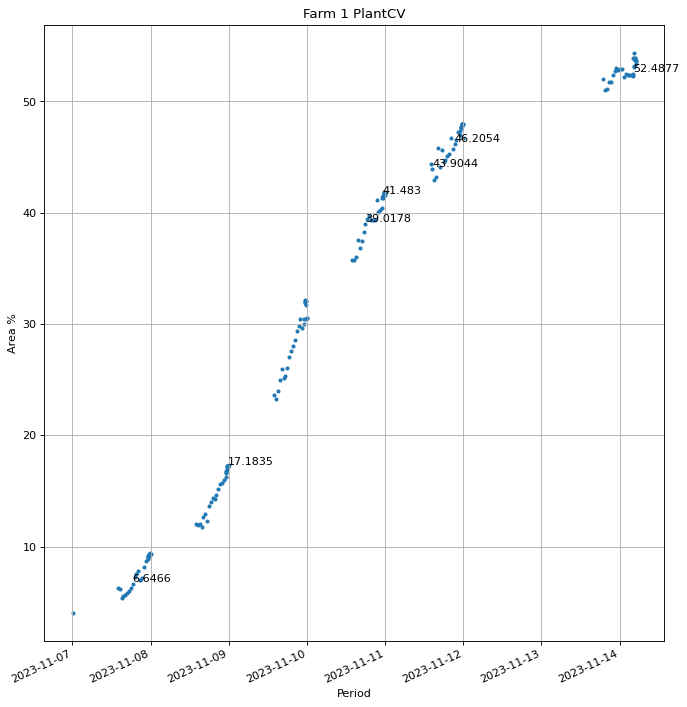

In [15]:
for instance in preprocessed_farm_data_list:
    plot_scatter(instance['Date'], instance['Area'], instance['Name'][0] + " PlantCV")

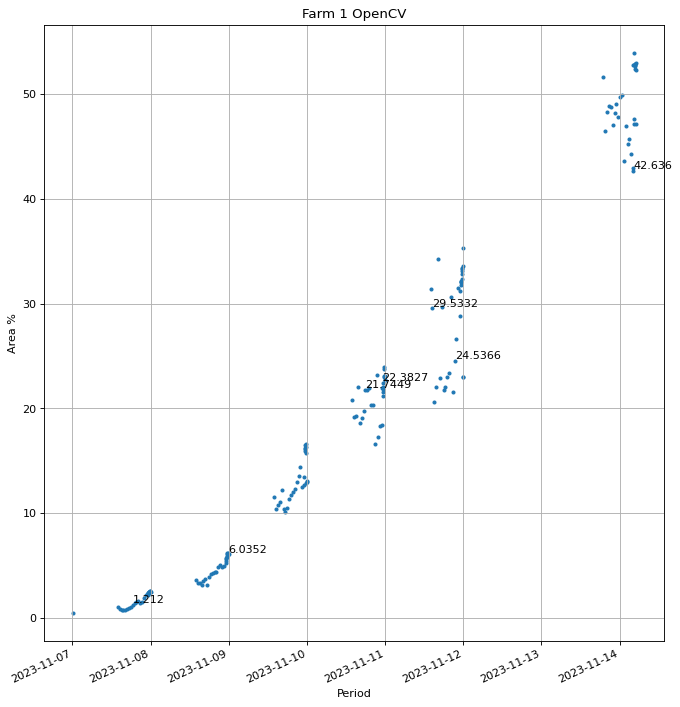

In [16]:
for instance in preprocessed_farm_data_list:
    plot_scatter(instance['Date'], instance['opencv'], instance['Name'][0] + " OpenCV")

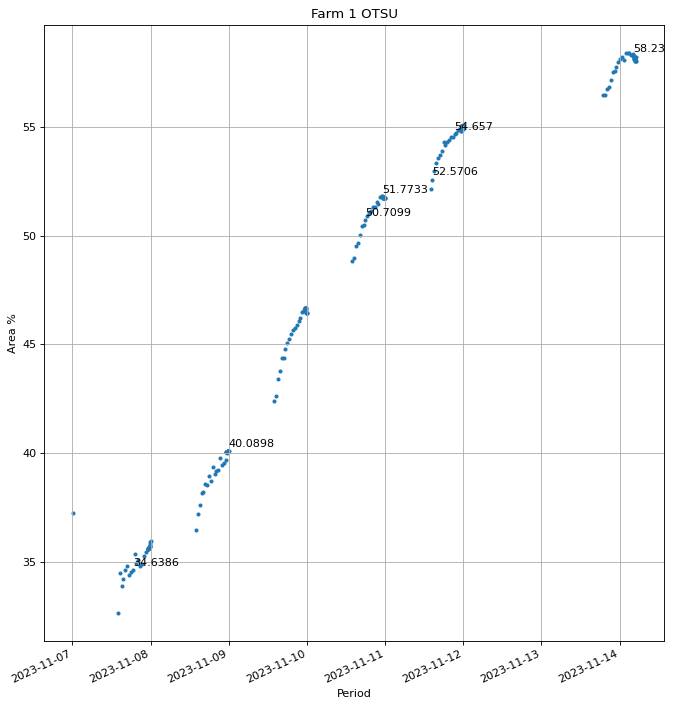

In [17]:
for instance in preprocessed_farm_data_list:
    plot_scatter(instance['Date'], instance['otsu'], instance['Name'][0] + " OTSU")

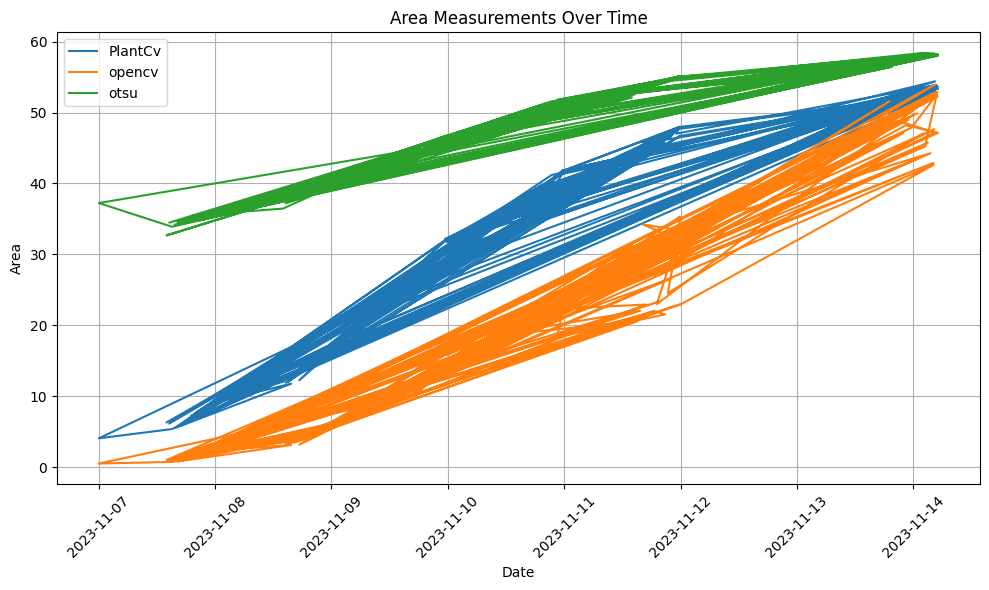

In [18]:
# Create the line chart
df = preprocessed_farm_data_list[0]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.plot(df['Date'], df['Area'], label='PlantCv')
plt.plot(df['Date'], df['opencv'], label='opencv')
plt.plot(df['Date'], df['otsu'], label='otsu')

# Customize the plot
plt.xlabel('Date')
plt.ylabel('Area')
plt.title('Area Measurements Over Time')
plt.xticks(rotation=45)  # Rotate x-axis labels for readability
plt.grid(True)  # Add grid lines for better visualization
plt.legend()  # Add legend to identify lines

# Display the plot
plt.tight_layout()
plt.show()

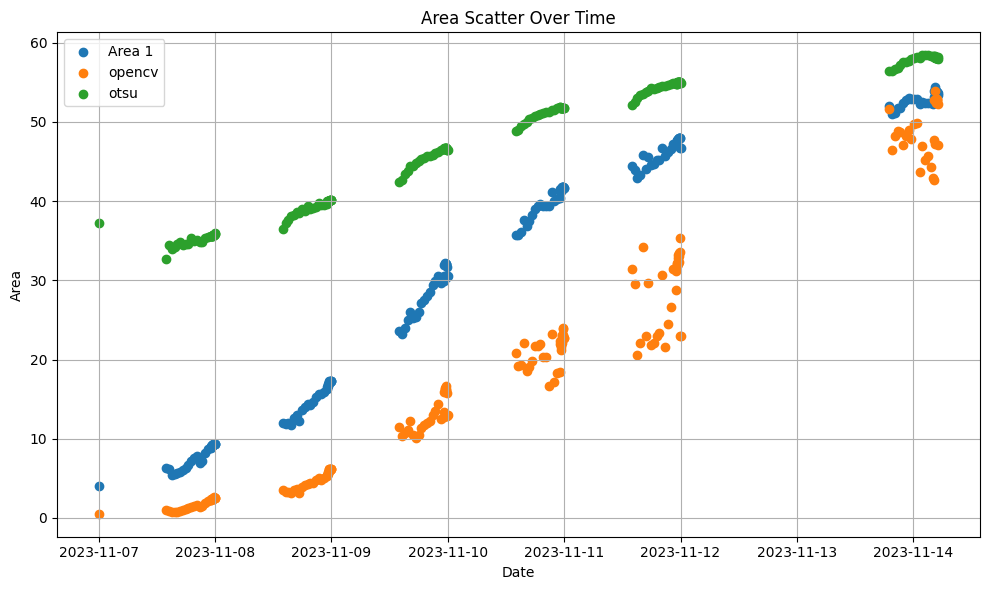

In [19]:
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.scatter(df['Date'], df['Area'], label='Area 1')
plt.scatter(df['Date'], df['opencv'], label='opencv')
plt.scatter(df['Date'], df['otsu'], label='otsu')

# Customize the plot
plt.xlabel('Date')
plt.ylabel('Area')
plt.title('Area Scatter Over Time')
plt.grid(True)  # Add grid lines for better visualization
plt.legend()  # Add legend to identify points

# Display the plot
plt.tight_layout()
plt.show()

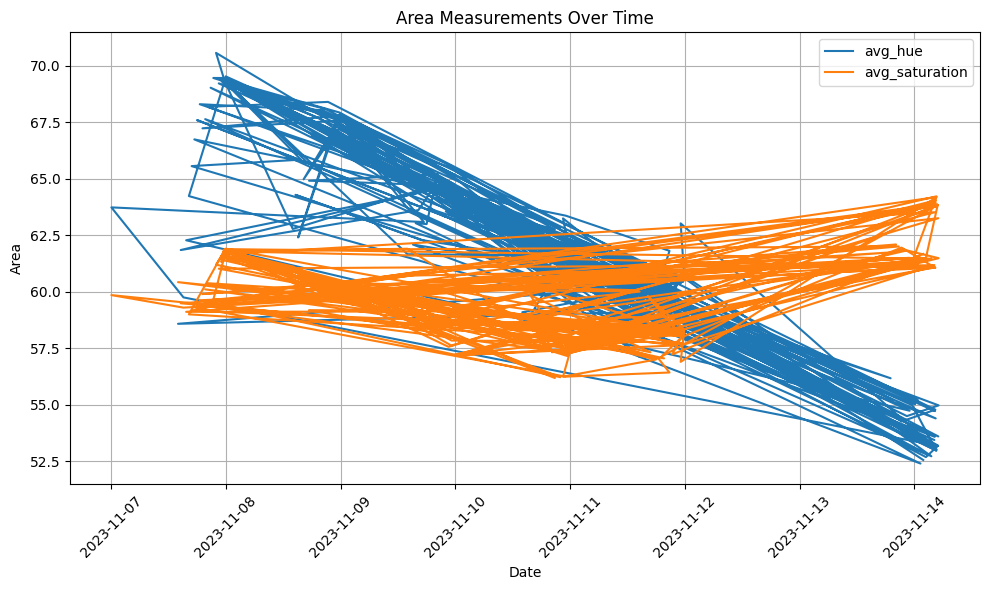

In [22]:
# Create the line chart
df = preprocessed_farm_data_list[0]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed

plt.plot(df['Date'], df['hue'], label='avg_hue')
plt.plot(df['Date'], df['saturation'], label='avg_saturation')
# plt.plot(df['Date'], df['value'], label='avg_value')

# Customize the plot
plt.xlabel('Date')
plt.ylabel('Area')
plt.title('Area Measurements Over Time')
plt.xticks(rotation=45)  # Rotate x-axis labels for readability
plt.grid(True)  # Add grid lines for better visualization
plt.legend()  # Add legend to identify lines

# Display the plot
plt.tight_layout()
plt.show()

In [4]:
class options:
    def __init__(self):        
        self.farm1 = ["./image/Farm 1/11-07-2023_00.01.58.jpg", './image/Farm 1/11-07-2023_23.57.01.jpg',
                     './image/Farm 1/11-08-2023_23.59.36.jpg', './image/Farm 1/11-09-2023_23.58.54.jpg',
                     './image/Farm 1/11-10-2023_23.58.34.jpg','./image/Farm 1/11-11-2023_23.57.04.jpg',
                      './image/Farm 1/11-12-2023_00.01.10.jpg','./image/Farm 1/11-13-2023_23.36.12.jpg',
                     './image/Farm 1/11-14-2023_05.06.12.jpg']
        
        self.farm2 = ["./image/Farm 2/11-07-2023_00.01.58.jpg", './image/Farm 2/11-07-2023_23.57.01.jpg',
                     './image/Farm 2/11-08-2023_23.59.36.jpg', './image/Farm 2/11-09-2023_23.58.54.jpg',
                     './image/Farm 2/11-10-2023_23.58.34.jpg', './image/Farm 2/11-11-2023_23.57.04.jpg',
                     './image/Farm 2/11-12-2023_00.01.10.jpg', './image/Farm 2/11-13-2023_23.36.12.jpg',
                     './image/Farm 2/11-14-2023_05.06.12.jpg']
        
        self.farm3 = ["./image/Farm 3/11-07-2023_00.01.58.jpg", './image/Farm 3/11-07-2023_23.57.01.jpg',
                     './image/Farm 3/11-08-2023_23.59.36.jpg', './image/Farm 3/11-09-2023_23.58.54.jpg',
                     './image/Farm 3/11-10-2023_23.58.34.jpg','./image/Farm 3/11-11-2023_23.57.04.jpg',
                      './image/Farm 3/11-12-2023_00.01.10.jpg','./image/Farm 3/11-13-2023_23.36.12.jpg',
                     './image/Farm 3/11-14-2023_05.06.12.jpg']
        
        self.farm4 = ["./image/Farm 4/11-07-2023_00.01.58.jpg", './image/Farm 4/11-07-2023_23.57.01.jpg',
                     './image/Farm 4/11-08-2023_23.59.36.jpg', './image/Farm 4/11-09-2023_23.58.54.jpg',
                     './image/Farm 4/11-10-2023_23.58.34.jpg','./image/Farm 4/11-11-2023_23.57.04.jpg',
                      './image/Farm 4/11-12-2023_00.01.10.jpg','./image/Farm 4/11-13-2023_23.36.12.jpg',
                     './image/Farm 4/11-14-2023_05.06.12.jpg']
        
        self.debug = "plot"
        self.writeimg = False
        self.result = "data_output"
        self.outdir = "img_output"
args = options()
pcv.params.debug_outdir = args.outdir
pcv.params.debug = args.debug

In [3]:
def rbg_image(img, farm_image_array):
    plant = plotImage(img)
    farm_image_array.append(plant)
    
    return farm_image_array
    
def plotImage(img):
    pil_im = PIL.Image.open(img, 'r')
    matplotlib.pyplot.imshow(np.asarray(pil_im))
    

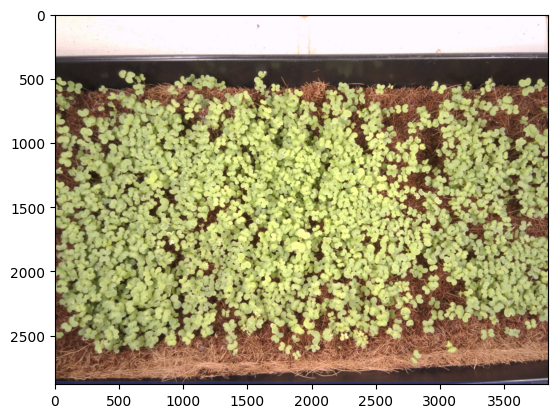

In [4]:
for img in args.farm2:
    plotImage(img)

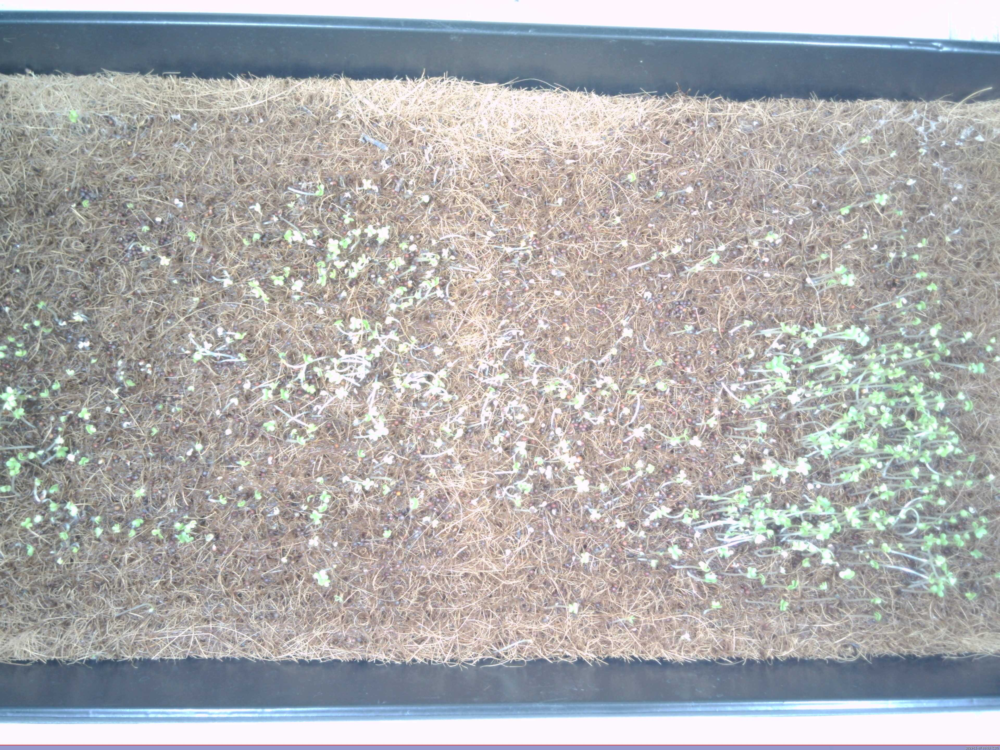

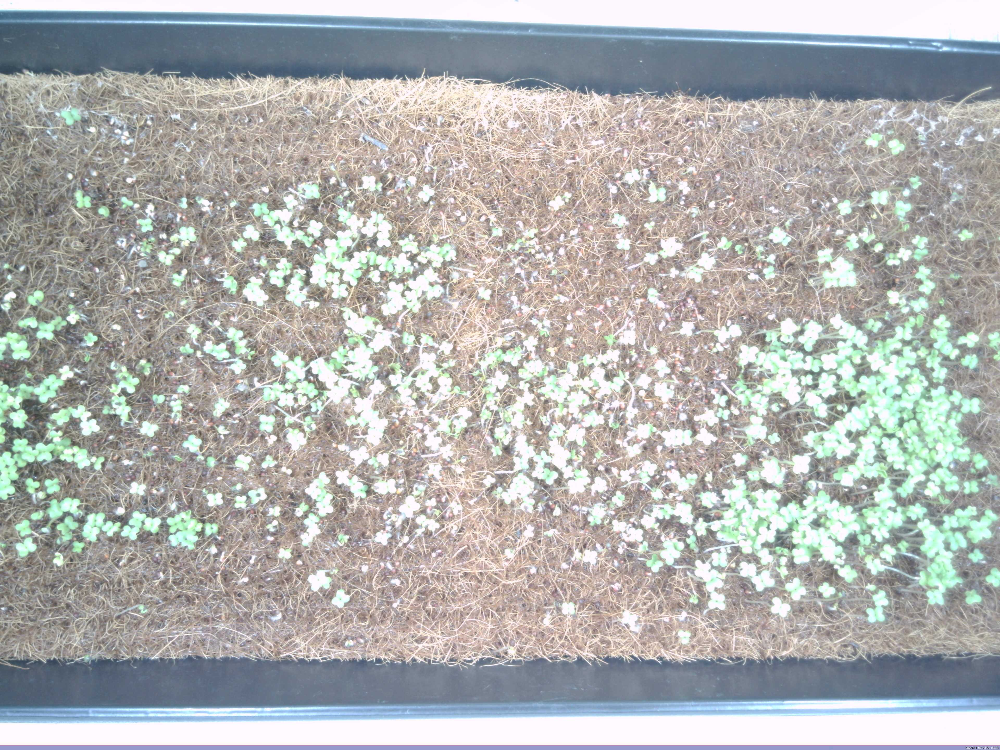

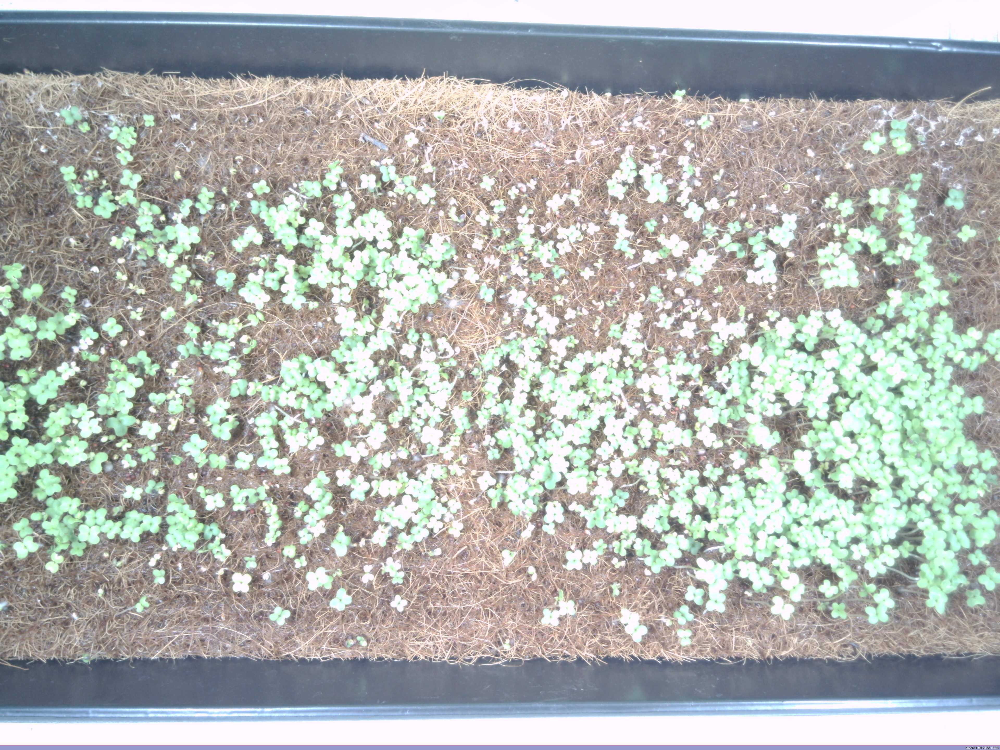

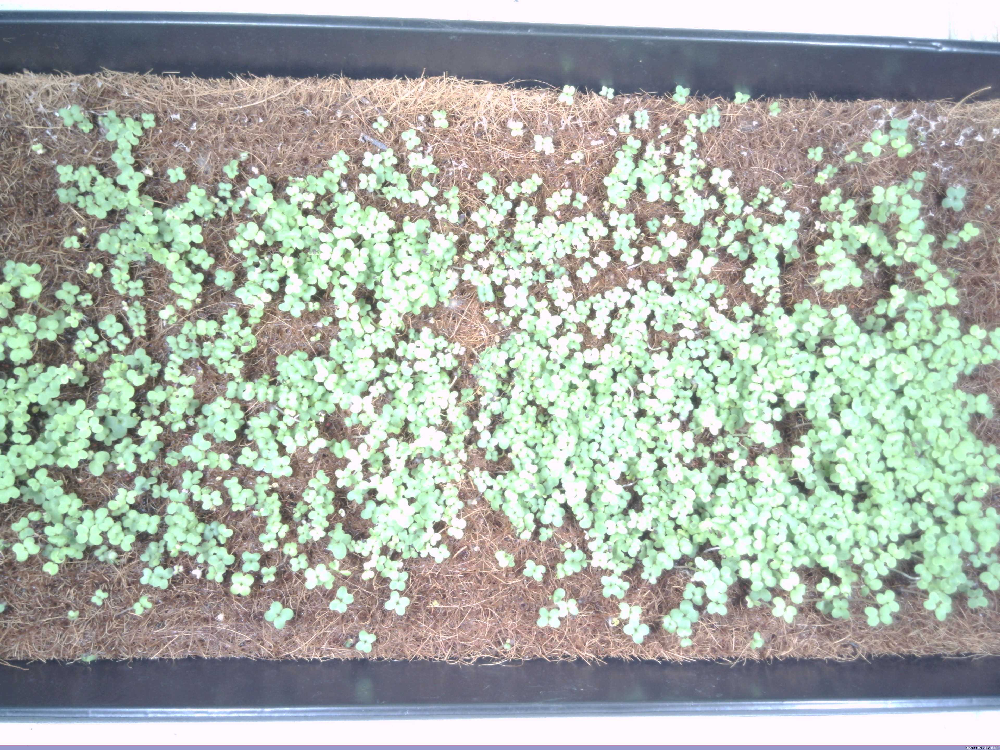

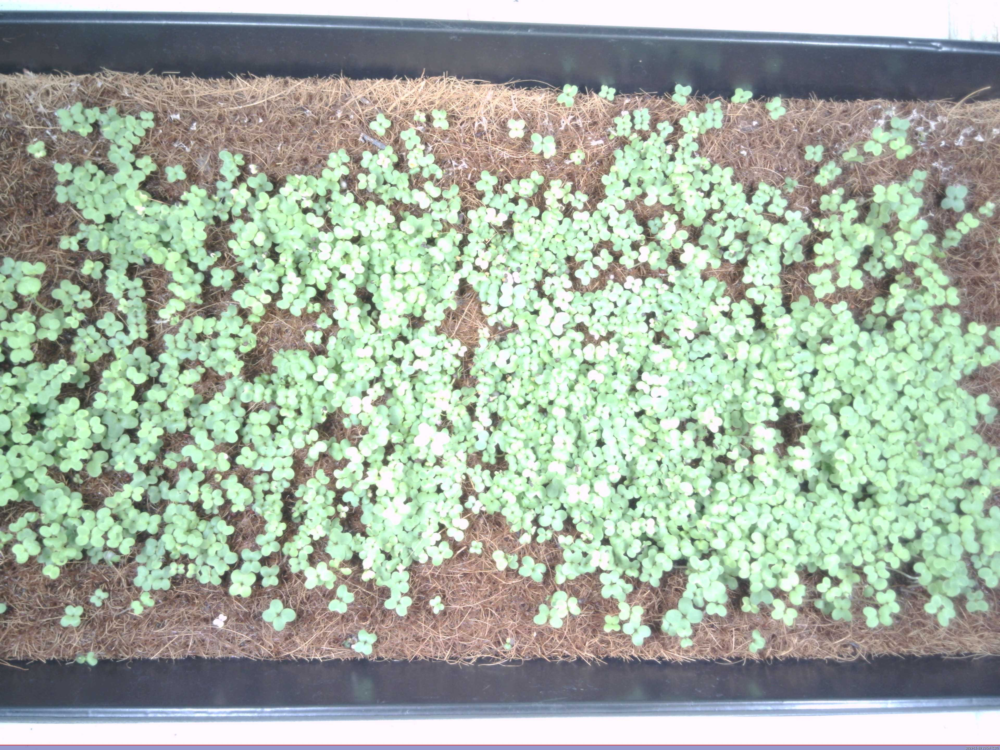

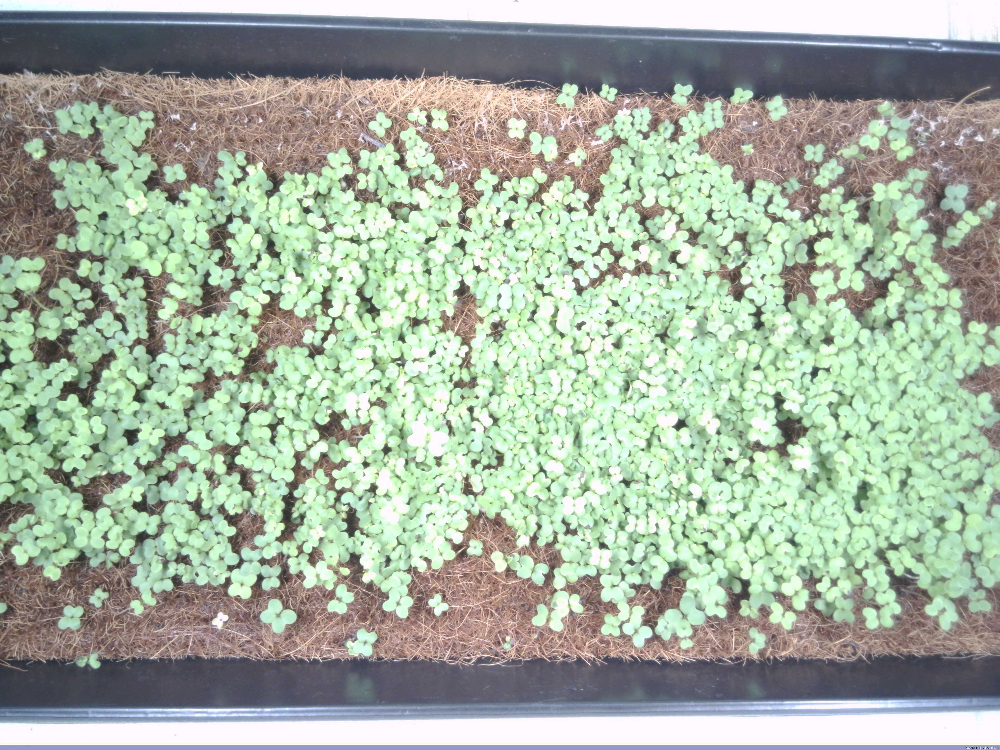

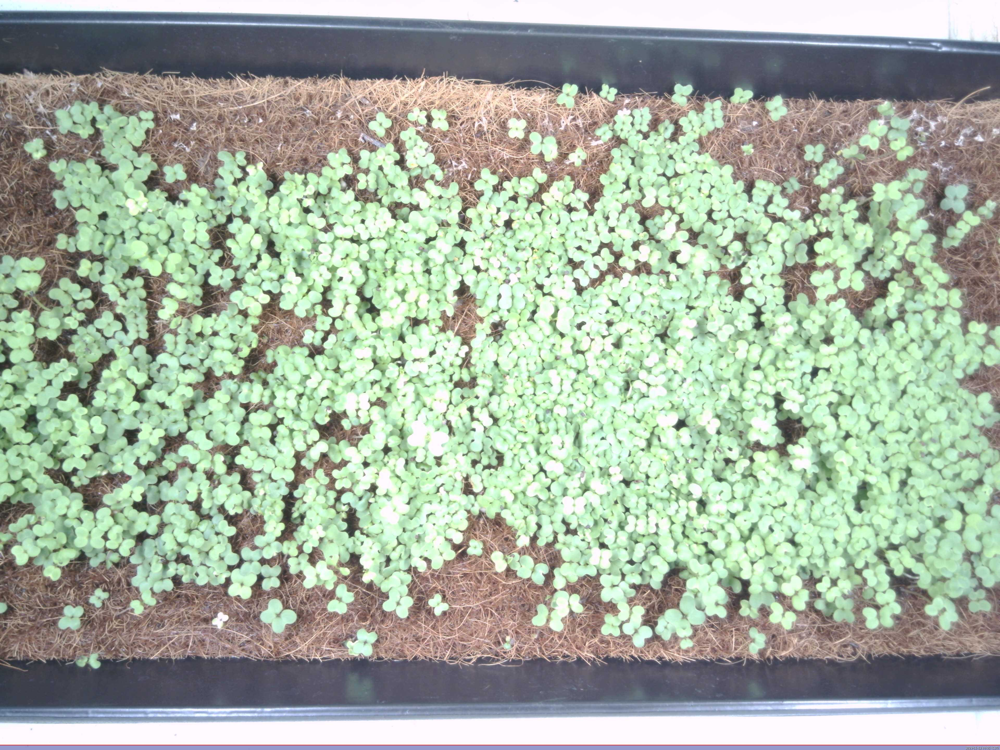

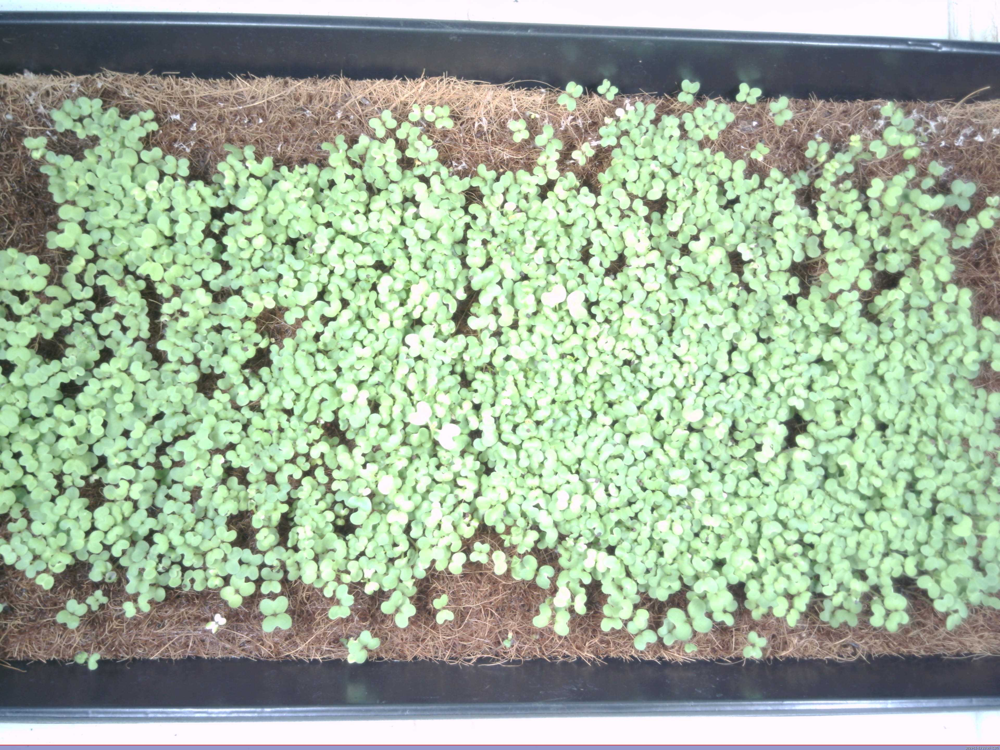

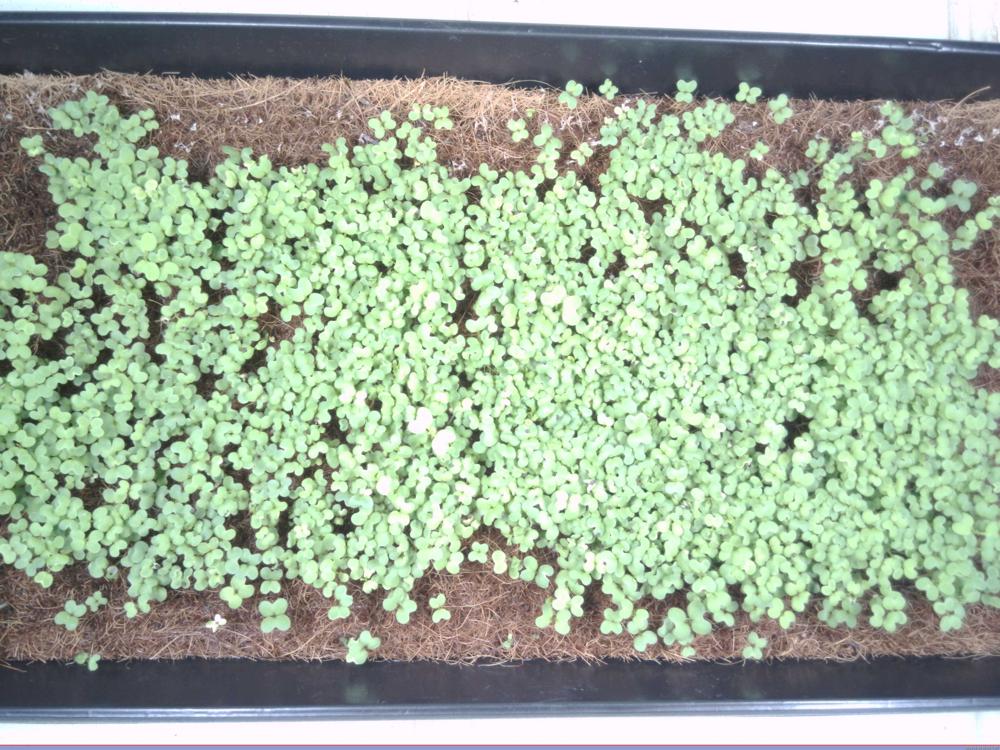

In [5]:
for image_path in args.farm1:
  # Display the image inline using IPython.display.Image
  display(Image(filename=image_path, width=100))

In [6]:
image_html = "".join(f'<img style="margin: 0px; float: left; border: 1px solid black;" src="{img}" width="100"/>' for img in args.farm1)


In [7]:
display(HTML(image_html))


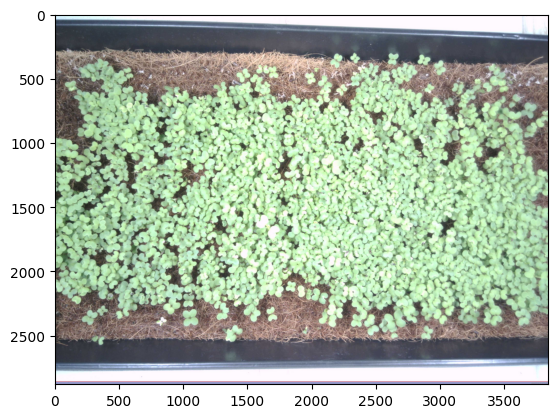

In [50]:
img, path, filename = pcv.readimage(args.farm1[-1])

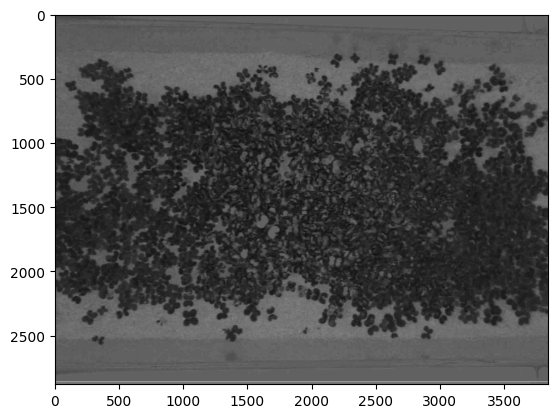

In [51]:
a = pcv.rgb2gray_lab(img, channel='a')

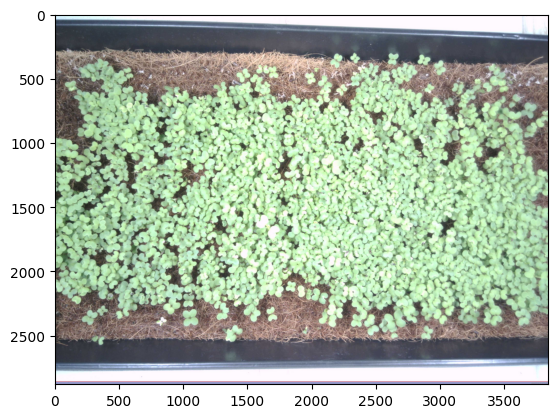

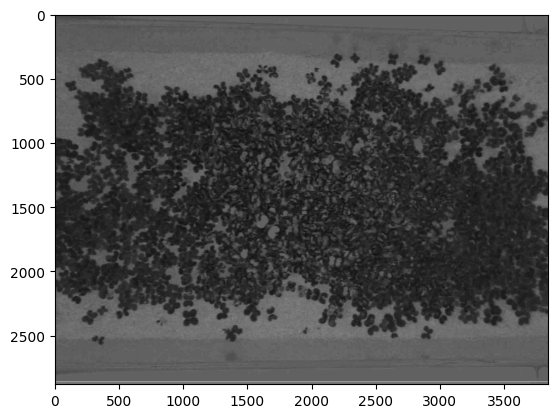

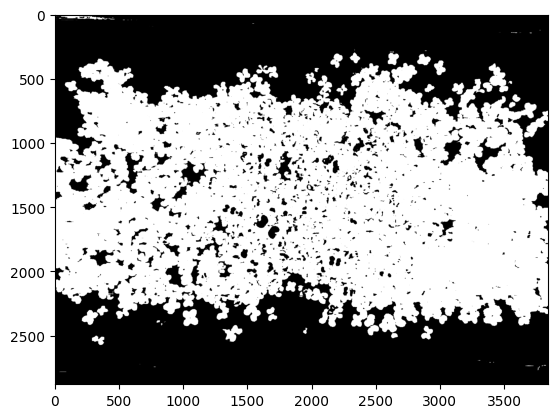

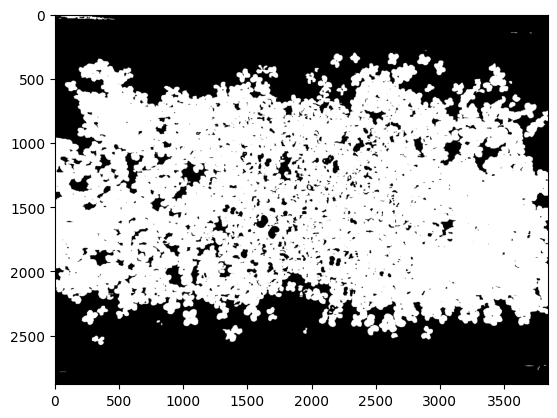

11059200


{'total_pix': 5899340, 'per': 53.34}

In [166]:
def extra_area_using_gray_scale(image_path):
    img, path, filename = pcv.readimage(image_path)
    # convert the image to grayscale colorspace
    a = pcv.rgb2gray_lab(img, channel='a')  
    # create the histogram of the grayscale image
    #hist = pcv.visualize.histogram(a)

    # threshold/segment plant material from the background 
    a_tresh = pcv.threshold.binary(gray_img=a, threshold=120, object_type='dark')

    # Fill in small objects
    a_fill_image = pcv.fill(bin_img=a_tresh, size=50)

    # count the number of white pixel which represent the plant material
    plantPixels = np.count_nonzero(a_fill_image)
    print(a_fill_image.size)
    return {"total_pix": plantPixels, "per": round(100 * (plantPixels/a_fill_image.size), 2)}
extra_area_using_gray_scale(args.farm1[-1])

In [52]:
hist = pcv.visualize.histogram(a)

alt.Chart(...)

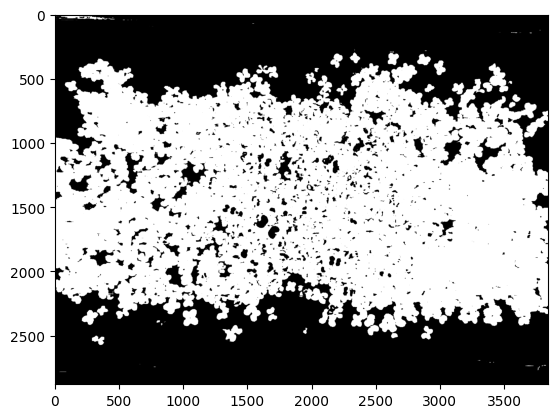

In [59]:
a_tresh = pcv.threshold.binary(gray_img=a, threshold=120, object_type='dark')

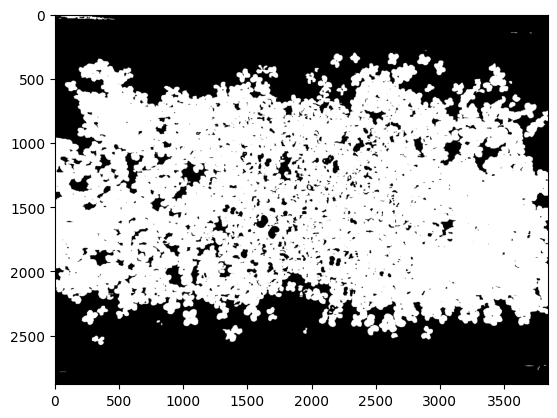

In [60]:
a_fill_image = pcv.fill(bin_img=a_tresh, size=50)


In [63]:
plantPixels = np.count_nonzero(a_fill_image)
print(round(1000*(plantPixels/11059200),2))

533.43


In [64]:
analysis_image = pcv.analyze.color(rgb_img=img, labeled_mask=a_tresh, n_labels=1, colorspaces='hsv')


alt.FacetChart(...)

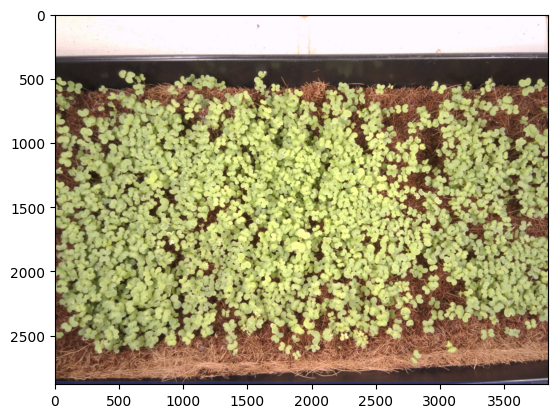

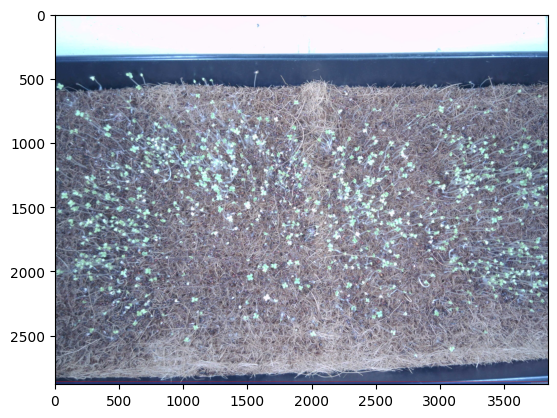

Image shape (Height, Width, Channels): (2880, 3840, 3)
Image shape (Height, Width, Channels): (2880, 3840, 3)


In [82]:
fg, _, _ = pcv.readimage(args.farm2[-1])
bg, _, _ = pcv.readimage(args.farm2[0])
print("Image shape (Height, Width, Channels):", fg.shape)
print("Image shape (Height, Width, Channels):", bg.shape)




364


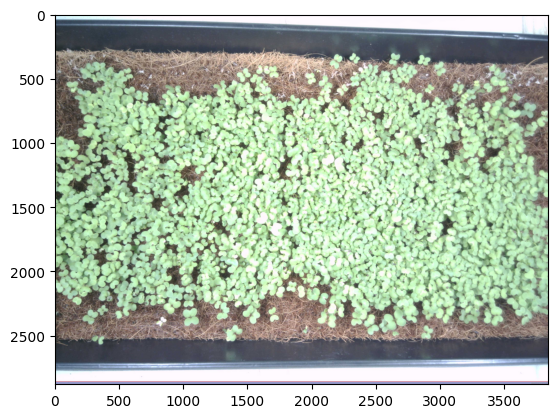

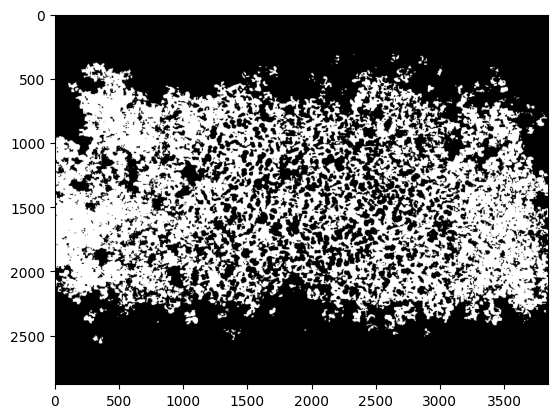

Estimated total microgreen area: {'total_pix': 5291978.5, 'per': 47.85} pixels


In [35]:
import cv2

def extract_microgreen_area(image_path):
  """
  Extracts the total microgreen area from an image.

  Args:
      image_path (str): Path to the image file.

  Returns:
      float: Estimated total area of microgreens in pixels.
  """

  # Read the image
  image = cv2.imread(image_path)

  # Convert to HSV color space (better color differentiation for plants)
  hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

  # Define color range for green (adjust based on your microgreens' color)
  # You can experiment with different ranges for better accuracy
  lower_green = np.array([40, 50, 50])
  upper_green = np.array([80, 255, 255])

  # Mask based on the green color range
  mask = cv2.inRange(hsv_image, lower_green, upper_green)

  # Apply morphological operations (optional)
  # Opening can remove noise, closing can fill small holes
  kernel = np.ones((5, 5), np.uint8)
  mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
  mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

  # Find contours of potential microgreens
  contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  # Assuming all contours belong to microgreens, calculate total area
  total_area = 0
  for cnt in contours:
    area = cv2.contourArea(cnt)
    total_area += area
  print(len(contours))

  # You can uncomment these lines to visualize the results
  pcv.plot_image(image)
  pcv.plot_image(mask)
  # cv2.imshow("Original Image", image)
  # cv2.imshow("Mask", mask)
  # cv2.waitKey(0)
  ih, iw, ic = image.shape
  tp = ih* iw
  return {"total_pix": total_area, "per": round(100 * (total_area/tp), 2)}

# Example usage
image_path = "./path/to/your/image.jpg"
microgreen_area = extract_microgreen_area(args.farm1[-1])
print("Estimated total microgreen area:", microgreen_area, "pixels")

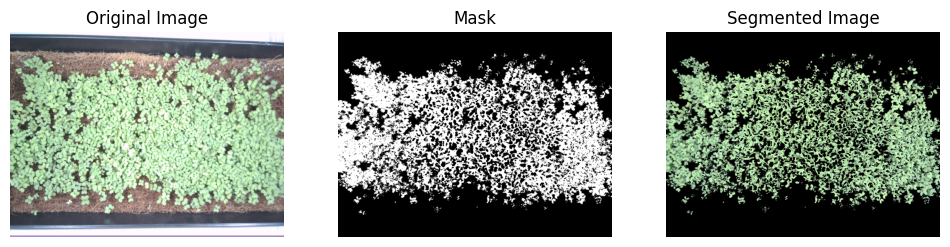

Green area percentage: 36.01%


In [45]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to segment the microgreen area
def segment_microgreen_area(image_path):
    # Read the image
    image = cv2.imread(image_path)
    # Convert the image from BGR to RGB color space
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Convert the image from RGB to HSV color space
    hsv_image = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2HSV)

    # Define range of green color in HSV
    lower_green = np.array([40, 50, 50])
    upper_green = np.array([90, 255, 255])

    # Threshold the HSV image to get only green colors
    mask = cv2.inRange(hsv_image, lower_green, upper_green)

    # Bitwise-AND mask and original image
    segmented_img = cv2.bitwise_and(rgb_image, rgb_image, mask=mask)

    # Optional: apply opening to remove noise
    kernel = np.ones((5, 5), np.uint8)
    opening = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Show the original and segmented images
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(rgb_image)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask, cmap='gray')
    plt.title('Mask')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(segmented_img)
    plt.title('Segmented Image')
    plt.axis('off')

    plt.show()

    # Calculate the green area percentage
    green_area = np.sum(mask > 0)
    total_area = image.shape[0] * image.shape[1]
    green_area_percentage = (green_area / total_area) * 100

    return green_area_percentage

# Replace 'your_image_path.jpg' with the path to your microgreen image
green_area_percentage = segment_microgreen_area(args.farm1[-1])
print(f'Green area percentage: {green_area_percentage:.2f}%')


<Figure size 1200x600 with 0 Axes>

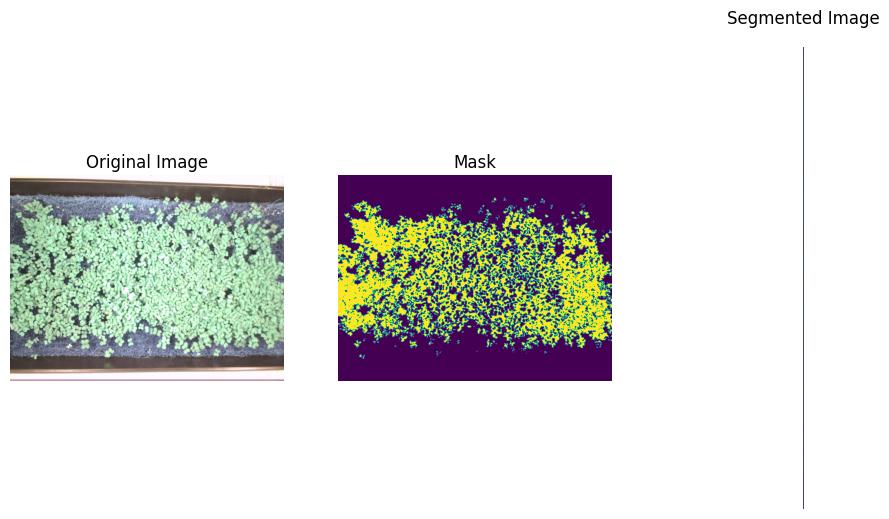

Total Microgreen Area: 5213752.5 pixels
Average Hue: 54.96484625998781
Average Saturation: 61.480104739595035
Average Value: 211.8246941565318
Circularity: 0.01240368975139317


In [53]:
import cv2
import numpy as np

def analyze_microgreen_growth(image_path):
  """
  Analyzes various parameters related to microgreen growth from an RGB image.

  Args:
      image_path (str): Path to the image file.

  Returns:
      dict: Dictionary containing calculated parameters (area, color features, shape features).
  """

  # Read the image
  image = cv2.imread(image_path)

  # Convert to HSV color space (better for plant color differentiation)
  hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

  # Define color range for green (adjust based on your microgreens' color)
  lower_green = np.array([40, 50, 50])
  upper_green = np.array([80, 255, 255])

  # Mask based on the green color range
  mask = cv2.inRange(hsv_image, lower_green, upper_green)

  # Apply morphological operations (optional)
  kernel = np.ones((5, 5), np.uint8)
  mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
  mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

  # Find contours of potential microgreens
  contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  # Analysis results dictionary
  results = {}

  # 1. Total Microgreen Area
  total_area = 0
  for cnt in contours:
    area = cv2.contourArea(cnt)
    total_area += area
  results["total_area"] = total_area

  # 2. Color Features
  # Extract average hue, saturation, and value from the mask
  mask_hsv = hsv_image[mask > 0]  # Get pixels within the mask
  avg_hue = np.mean(mask_hsv[:, 0])
  avg_saturation = np.mean(mask_hsv[:, 1])
  avg_value = np.mean(mask_hsv[:, 2])
  results["avg_hue"] = avg_hue
  results["avg_saturation"] = avg_saturation
  results["avg_value"] = avg_value

  # 3. Shape Features (assuming a single dominant microgreen patch)
  if len(contours) > 0:
    largest_contour = max(contours, key=cv2.contourArea)
    perimeter = cv2.arcLength(largest_contour, True)
    # You can calculate other shape features here (e.g., aspect ratio, solidity)
    circularity = (4.0 * np.pi * total_area) / (perimeter * perimeter)
    results["circularity"] = circularity

  # You can uncomment these lines to visualize the results
  # cv2.imshow("Original Image", image)
  # cv2.imshow("Mask", mask)
  # cv2.waitKey(0)

  plt.figure(figsize=(12, 6))
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 3, 1)
  plt.imshow(image)
  plt.title('Original Image')
  plt.axis('off')

  plt.subplot(1, 3, 2)
  plt.imshow(mask)
  plt.title('Mask')
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.imshow(mask_hsv)
  plt.title('Segmented Image')
  plt.axis('off')

  plt.show()  

  return results

# Example usage
image_path = args.farm1[-1]
microgreen_data = analyze_microgreen_growth(image_path)

print("Total Microgreen Area:", microgreen_data["total_area"], "pixels")
print("Average Hue:", microgreen_data["avg_hue"])
print("Average Saturation:", microgreen_data["avg_saturation"])
print("Average Value:", microgreen_data["avg_value"])

# If a dominant patch is detected, print circularity
if "circularity" in microgreen_data:
  print("Circularity:", microgreen_data["circularity"])

In [57]:
from skimage.segmentation import watershed
# from skimage.morphology import gradient, dilation
from skimage.filters import sobel

def segment_microgreens(image_path):
  """
  Segments microgreens in an image using watershed transformation.

  Args:
      image_path (str): Path to the image file.

  Returns:
      numpy.ndarray: Segmented image with labels for each microgreen region.
  """

  # Read the image
  image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Convert to grayscale for watershed

  # Apply morphological gradient to enhance edges
  grad = gradient(image)

  # Optional dilation to increase separation between objects (adjust if needed)
  # Dilation can help separate touching objects but might also merge slightly separated ones
  # dilated_grad = dilation(grad, selem=np.ones((3, 3)))

  # Perform watershed segmentation
  markers = skimage.measure.regionprops(skimage.morphology.binary_dilation(image, selem=np.ones((3, 3))))
  markers = [marker.centroid for marker in markers]
  segmentation = watershed(grad, markers=markers, mask=image > image.mean())

  return segmentation

# Example usage
image_path = args.farm1[-1]
segmentation = segment_microgreens(image_path)

# Visualize results (optional)
import matplotlib.pyplot as plt

plt.imshow(segmentation, cmap="viridis")
plt.colorbar()
plt.title("Watershed Segmentation")
plt.show()


NameError: name 'gradient' is not defined

In [58]:
from skimage.filters import sobel
from skimage.morphology import dilation

def segment_microgreens(image_path):
  """
  Segments microgreens in an image using Sobel filter and watershed transformation.

  Args:
      image_path (str): Path to the image file.

  Returns:
      numpy.ndarray: Segmented image with labels for each microgreen region.
  """

  # Read the image
  image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Convert to grayscale

  # Apply Sobel filter to calculate gradients
  grad_x, grad_y = sobel(image)
  grad = np.sqrt(grad_x**2 + grad_y**2)  # Calculate gradient magnitude

  # Optional dilation to increase separation between objects (adjust if needed)
  # Dilation can help separate touching objects but might also merge slightly separated ones
  dilated_grad = dilation(grad, selem=np.ones((3, 3)))

  # Perform watershed segmentation
  markers = skimage.measure.regionprops(skimage.morphology.binary_dilation(image, selem=np.ones((3, 3))))
  markers = [marker.centroid for marker in markers]
  segmentation = watershed(dilated_grad, markers=markers, mask=image > image.mean())

  return segmentation

# Example usage
image_path =  args.farm1[-1]
segmentation = segment_microgreens(image_path)

# Visualize results (optional)
import matplotlib.pyplot as plt

plt.imshow(segmentation, cmap="viridis")
plt.colorbar()
plt.title("Watershed Segmentation with Sobel Gradient")
plt.show()

ValueError: too many values to unpack (expected 2)

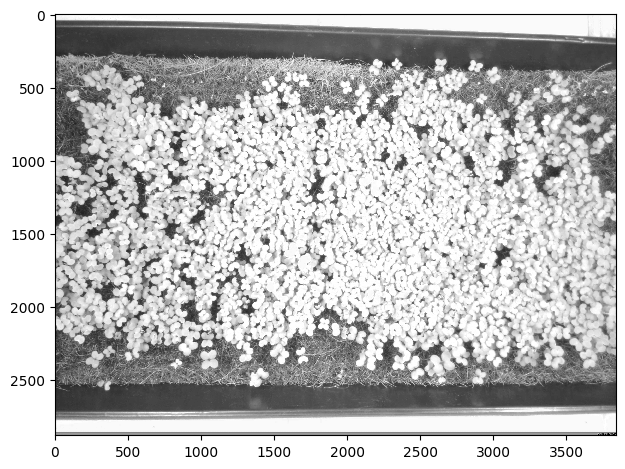

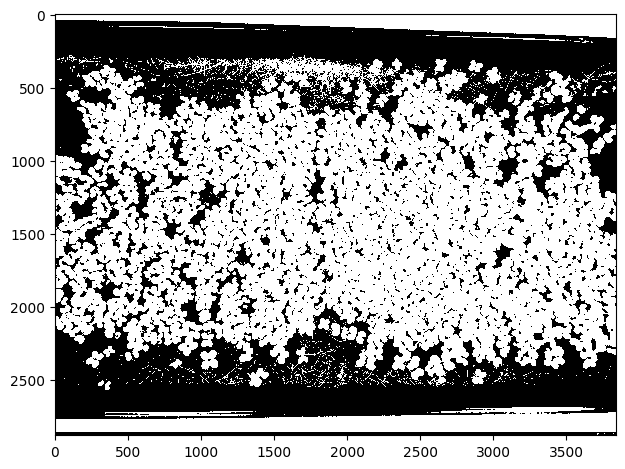

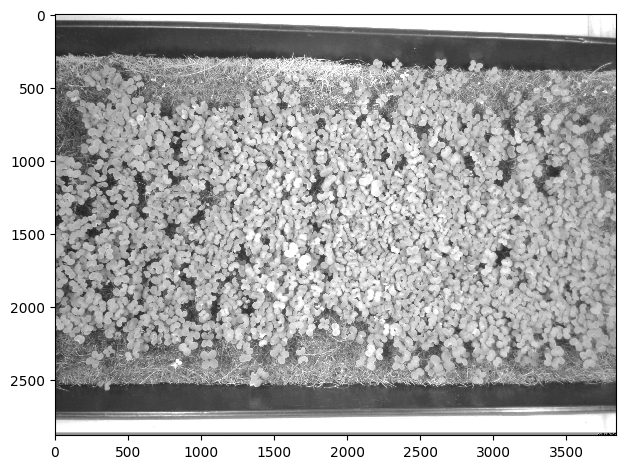

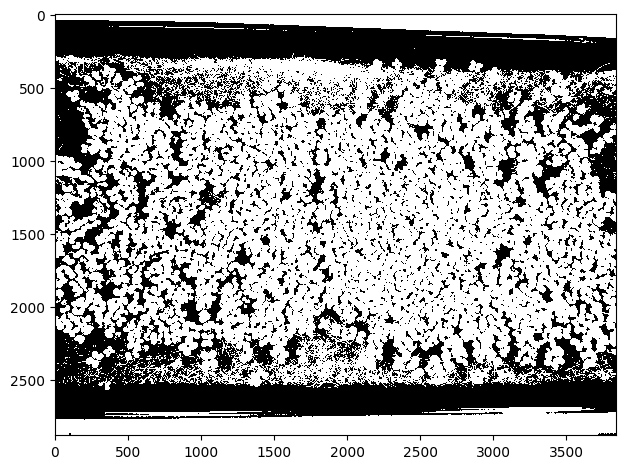

In [28]:
import numpy as np
from skimage import io, color
from skimage.filters import threshold_otsu

# Load the image
image = io.imread(args.farm1[-1])

# Extract the green channel
green_channel = image[:, :, 1]
red_channel = image[:, :, 0]
blue_channel = image[:, :, 2]

# Display the channels
# io.imshow(red_channel)
# io.show()
# io.imshow(blue_channel)
# io.show()

# Apply Otsu's threshold to the green channel to segment the image
thresh = threshold_otsu(green_channel)
binary = green_channel > thresh

# Display the original green channel and the binary image
io.imshow(green_channel)
io.show()
io.imshow(binary)
io.show()

thresh = threshold_otsu(red_channel)
binary = red_channel > thresh
io.imshow(red_channel)
io.show()
io.imshow(binary)
io.show()


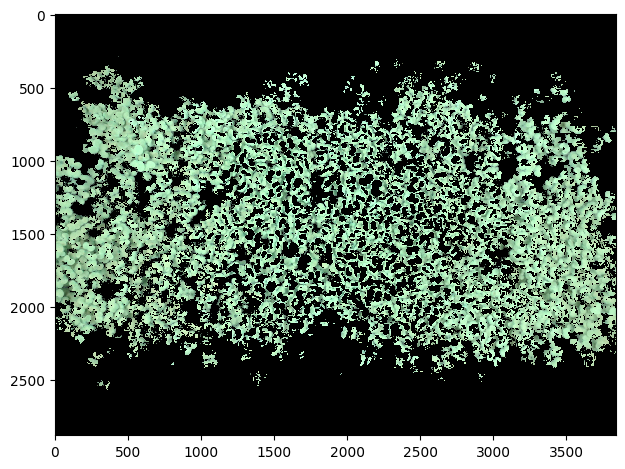

In [61]:
def filter_green_pixels(image_path):
  """
  Filters pixels that don't have a single green value (assuming greyish background).

  Args:
      image_path (str): Path to the image file.

  Returns:
      numpy.ndarray: Image with only green pixels remaining.
  """

  # Read the image
  image = cv2.imread(image_path)

  # Convert to HSV color space
  hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

  # Define thresholds for isolating green pixels (adjust based on your image)
  lower_green = np.array([40, 50, 50])
  upper_green = np.array([80, 255, 255])

  # Create a mask based on the green color range
  mask = cv2.inRange(hsv_image, lower_green, upper_green)

  # Apply bitwise AND with the original image to keep only green pixels
  filtered_image = cv2.bitwise_and(image, image, mask=mask)

  return filtered_image
image_path = args.farm1[-1]
filtered_image = filter_green_pixels(image_path)
io.imshow(filtered_image)

ValueError: too many values to unpack (expected 2)

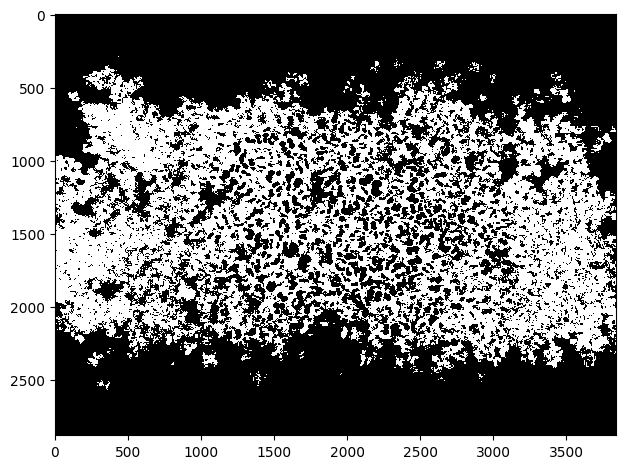

In [65]:
import cv2
import numpy as np
from skimage.segmentation import flood_fill
from skimage.measure import regionprops

def analyze_microgreens(image_path):
  """
  Analyzes various features of microgreens in an image.

  Args:
      image_path (str): Path to the image file.

  Returns:
      dict: Dictionary containing calculated features (area, green channel mean, other features).
  """

  # Read the image
  image = cv2.imread(image_path)

  # Convert to HSV color space (better for plant color differentiation)
  hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

  # Define color range for green (adjust based on your microgreens' color)
  lower_green = np.array([40, 50, 50])
  upper_green = np.array([80, 255, 255])

  # Create a mask to isolate green pixels potentially belonging to microgreens
  mask = cv2.inRange(hsv_image, lower_green, upper_green)
  io.imshow(mask)
  # Apply morphological operations (optional)
  kernel = np.ones((5, 5), np.uint8)
  mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
  io.imshow(gray_image)
  mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

  # Find contours of potential microgreens
  contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  # Analysis results dictionary
  results = {}

  # 1. Microgreen Area
  total_area = 0
  for cnt in contours:
    area = cv2.contourArea(cnt)
    total_area += area
  results["total_area"] = total_area

  # 2. Green Channel (Average)
  # Extract green channel from HSV image and calculate average within the mask
  green_channel = hsv_image[:, :, 1]
  avg_green = np.mean(green_channel[mask > 0])
  results["avg_green"] = avg_green

  # 3. Other Features (extract from individual contours)
  if len(contours) > 0:
    # You can extract various features here
    # Example: Eccentricity (measures how circular a shape is)
    for cnt in contours:
      x, y, w, h = cv2.boundingRect(cnt)
      # Calculate eccentricity (close to 0 for circle, 1 for line segment)
      eccentricity, _ = cv2.fitEllipse(cnt)
      results["eccentricity"] = eccentricity  # You can add this to the results dictionary

  # You can add more features based on your needs (e.g., circularity, convexity)
  # Consider using flood_fill for more advanced segmentation if needed

  return results

# Example usage
image_path = args.farm1[-1]
microgreen_data = analyze_microgreens(image_path)

print("Total Microgreen Area:", microgreen_data["total_area"], "pixels")
print("Average Green Channel:", microgreen_data["avg_green"])

# If features were extracted from individual contours
if "eccentricity" in microgreen_data:
  print("Eccentricity:", microgreen_data["eccentricity"])


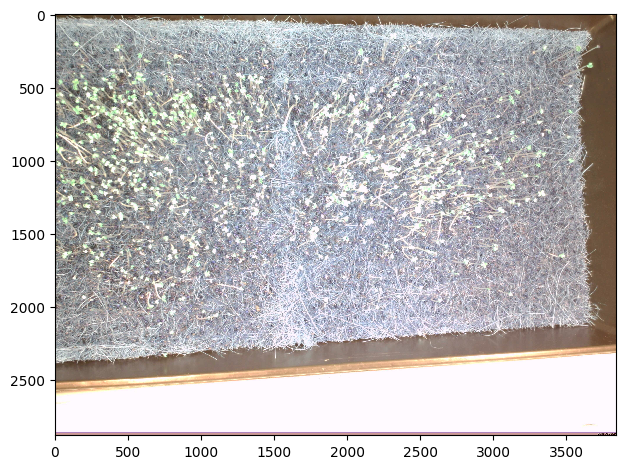

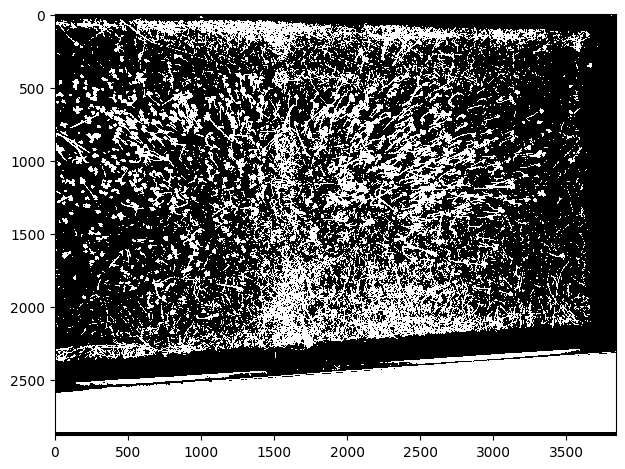

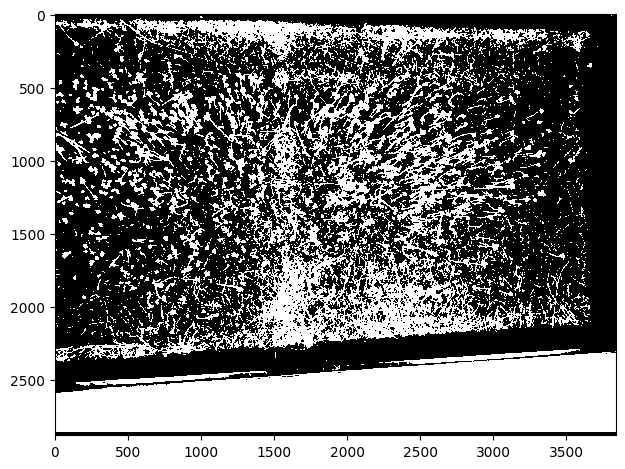

Total Microgreen Area: 4192777 pixels


In [33]:
import cv2
import numpy as np
from skimage.segmentation import flood_fill, watershed
from skimage.measure import regionprops

def analyze_microgreens(image_path):
  """
  Analyzes various features of microgreens in an image using Otsu's thresholding.

  Args:
      image_path (str): Path to the image file.

  Returns:
      dict: Dictionary containing calculated features (area, green channel mean, other features).
  """

  # Read the image
  image = cv2.imread(image_path)
  io.imshow(image)
  io.show()
  # Convert to grayscale for Otsu's thresholding
  gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  # io.imshow(gray_image)
  # io.show()

  # Apply Otsu's thresholding to segment potential microgreen regions
  thresh, mask = cv2.threshold(gray_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

  # Optional morphological operations (refine mask)
  kernel = np.ones((5, 5), np.uint8)
  mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
  io.imshow(mask)
  io.show()
  mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
  io.imshow(mask)
  io.show()
  # Analysis results dictionary
  results = {}

  # 1. Microgreen Area
  total_area = np.sum(mask > 0)
  results["total_area"] = total_area

  # 2. Green Channel (Average) - consider alternative for grayscale image
  # Since we're using a grayscale image, extracting the green channel might not be relevant.
  # You can explore color conversion or alternative green intensity estimation if needed.

  # 3. Other Features (extract from individual contours)
  # if np.count_nonzero(mask) > 0:
  #   # You can extract various features here
  #   # Example: Eccentricity (measures how circular a shape is)
  #   labels = flood_fill(mask, seed_point=None, seed_fill_value=255)  # Flood fill for potential gaps
  #   props = regionprops(labels, image)

  #   for prop in props:
  #     # Calculate eccentricity (close to 0 for circle, 1 for line segment)
  #     eccentricity, _ = cv2.fitEllipse(prop["coords"])
  #     results["eccentricity"] = eccentricity  # You can add this to the results dictionary

  # You can add more features based on your needs (e.g., circularity, convexity)
  # Consider watershed segmentation for potentially more complex overlapping microgreens

  return results

# Example usage
image_path = args.farm4[0]
microgreen_data = analyze_microgreens(image_path)

print("Total Microgreen Area:", microgreen_data["total_area"], "pixels")

# If features were extracted from individual contours
if "eccentricity" in microgreen_data:
  print("Eccentricity:", microgreen_data["eccentricity"])
